## Semantic Segmentation on cityscapes dataset

### Importing modules

In [ ]:
import math
from PIL import Image, ImageDraw
from PIL import ImagePath
import pandas as pd
import os
from os import path
from tqdm import tqdm
import json
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import urllib
import imgaug.augmenters as iaa
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense,Input,Conv2D,MaxPool2D,Activation,Dropout,Flatten, BatchNormalization, ReLU, Reshape
from tensorflow.keras.models import Model
import random as rn
import imgaug.augmenters as iaa
from tensorflow.keras.layers import Flatten
from sklearn.model_selection import train_test_split

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!unzip '/content/drive/MyDrive/Image_segm/gtFine_trainvaltest.zip'

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: gtFine/test/berlin/berlin_000117_000019_gtFine_color.png  
  inflating: gtFine/test/berlin/berlin_000114_000019_gtFine_color.png  
  inflating: gtFine/test/berlin/berlin_000434_000019_gtFine_labelIds.png  
  inflating: gtFine/test/berlin/berlin_000420_000019_gtFine_color.png  
  inflating: gtFine/test/berlin/berlin_000483_000019_gtFine_instanceIds.png  
  inflating: gtFine/test/berlin/berlin_000420_000019_gtFine_instanceIds.png  
  inflating: gtFine/test/berlin/berlin_000254_000019_gtFine_color.png  
  inflating: gtFine/test/berlin/berlin_000490_000019_gtFine_color.png  
  inflating: gtFine/test/berlin/berlin_000448_000019_gtFine_polygons.json  
  inflating: gtFine/test/berlin/berlin_000099_000019_gtFine_labelIds.png  
  inflating: gtFine/test/berlin/berlin_000068_000019_gtFine_instanceIds.png  
  inflating: gtFine/test/berlin/berlin_000288_000019_gtFine_instanceIds.png  
  inflating: gtFine/test/berlin/be

In [ ]:
!unzip '/content/drive/MyDrive/Image_segm/leftImg8bit_trainvaltest.zip'

Выходные данные были обрезаны до нескольких последних строк (5000).
 extracting: leftImg8bit/train/jena/jena_000074_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000040_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000020_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000030_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000005_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000059_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000100_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000034_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000089_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000104_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000107_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000080_000019_leftImg8bit.png  
 extracting: leftImg8bit/train/jena/jena_000006_000019_l

Создание датафрейма, в котором 2 столбца:
1. Image - путь к картинке
2. Json - путь к json файлу

In [ ]:
def return_file_df(type_of_df):
  #make lists
  images_paths = []
  json_paths = []
  #paths
  path_json = '/content/gtFine'
  path_json = os.path.join(path_json,type_of_df)
  json_suffix = 'gtFine_polygons.json'
  path_img = '/content/leftImg8bit' 
  path_img = os.path.join(path_img,type_of_df)
  #going into folders
  for folder in os.listdir(path_img):
    path_1 = os.path.join(path_img,folder)
    images = os.listdir(path_1)
    #appending file_names into json and image path list
    for image in images:
            img_name = image.split('left')[0]
            images_paths.append(os.path.join(path_1,image))
            json_paths.append(os.path.join(path_json,folder,img_name+json_suffix))

  #creating Dataframe 
  data_df = pd.DataFrame()
  data_df['image'] = images_paths
  data_df['json'] = json_paths
  return data_df

In [ ]:
train_df = return_file_df('train')
test_df = return_file_df('test')
val_df = return_file_df('val')

In [ ]:
for i in np.random.choice(range(0,len(train_df)),7):
    print(train_df.iloc[i][0])
    print(train_df.iloc[i][1])
    print('\n')

/content/leftImg8bit/train/jena/jena_000003_000019_leftImg8bit.png
/content/gtFine/train/jena/jena_000003_000019_gtFine_polygons.json


/content/leftImg8bit/train/dusseldorf/dusseldorf_000115_000019_leftImg8bit.png
/content/gtFine/train/dusseldorf/dusseldorf_000115_000019_gtFine_polygons.json


/content/leftImg8bit/train/stuttgart/stuttgart_000141_000019_leftImg8bit.png
/content/gtFine/train/stuttgart/stuttgart_000141_000019_gtFine_polygons.json


/content/leftImg8bit/train/stuttgart/stuttgart_000019_000019_leftImg8bit.png
/content/gtFine/train/stuttgart/stuttgart_000019_000019_gtFine_polygons.json


/content/leftImg8bit/train/dusseldorf/dusseldorf_000133_000019_leftImg8bit.png
/content/gtFine/train/dusseldorf/dusseldorf_000133_000019_gtFine_polygons.json


/content/leftImg8bit/train/strasbourg/strasbourg_000000_020653_leftImg8bit.png
/content/gtFine/train/strasbourg/strasbourg_000000_020653_gtFine_polygons.json


/content/leftImg8bit/train/zurich/zurich_000005_000019_leftImg8bit.png
/

In [ ]:
# check dataframe
def check_1(data_df):
    for i in data_df.values:
        if not path.isfile(i[0]) and path.isfile(i[1]):
            return False
    return True

check_1(train_df)

True

In [ ]:
train_df.shape, test_df.shape

((2975, 2), (1525, 2))

### Json file

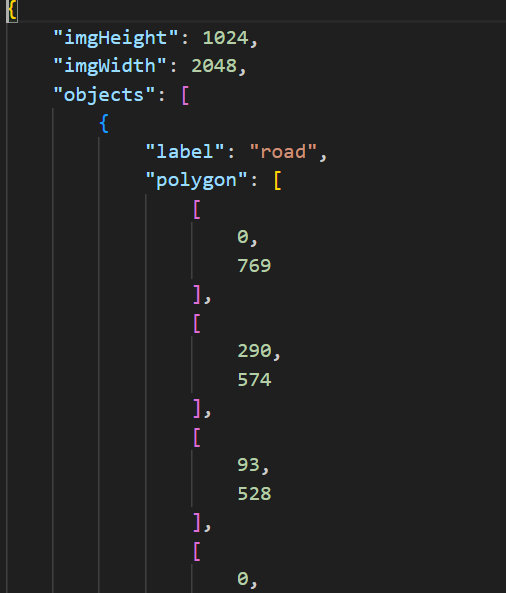

В json файле есть высота и ширина фото, а также ключ objects, в котором хранятся labels

Для начала получим все уникальные значения для labels

In [ ]:
def return_unique_labels(data_df):
    # I'm going to add every label to set
    unique_labels = set()
    #iterating over each json file
    for path in tqdm(data_df['json'].values):
        file = open(path)
        json_data = json.load(file)
        #iterating over all objects in json file
        for i in json_data['objects']:
            label = i['label']
            unique_labels.add(label)
    return list(unique_labels)

unique_labels = return_unique_labels(train_df)
unique_labels

100%|██████████| 2975/2975 [00:22<00:00, 129.45it/s]


['motorcyclegroup',
 'terrain',
 'out of roi',
 'vegetation',
 'dynamic',
 'motorcycle',
 'train',
 'ridergroup',
 'traffic light',
 'person',
 'trailer',
 'bridge',
 'polegroup',
 'fence',
 'rail track',
 'car',
 'persongroup',
 'rider',
 'rectification border',
 'building',
 'road',
 'cargroup',
 'license plate',
 'tunnel',
 'bus',
 'traffic sign',
 'guard rail',
 'wall',
 'truck',
 'static',
 'ego vehicle',
 'truckgroup',
 'ground',
 'sidewalk',
 'sky',
 'caravan',
 'pole',
 'parking',
 'bicyclegroup',
 'bicycle']

In [ ]:
len(unique_labels)

40

Зададим каждому классу числовое значение с разницей между соседними в 10

In [ ]:
label2num = {'guard rail': 120, 'traffic light': 130, 'motorcycle': 80, 'bicyclegroup': 80, 'vegetation': 160, 'tunnel': 150, 'building': 150,'bus': 100,
 'ground': 190, 'caravan': 100, 'sky': 170, 'bicycle': 80, 'terrain': 160, 'polegroup': 140, 'rectification border': 200, 'static': 10,
 'trailer': 100, 'road': 20, 'traffic sign': 130, 'sidewalk': 40, 'train': 210, 'pole': 140, 'dynamic': 60, 'ego vehicle': 180, 'truck': 100,
 'person': 60, 'parking': 30, 'wall': 110, 'bridge': 150, 'persongroup': 60, 'motorcyclegroup': 80, 'license plate': 130, 'rail track': 50,
 'truckgroup': 100, 'cargroup': 90, 'ridergroup': 70, 'car': 90, 'out of roi': 0, 'rider': 70, 'fence': 120}

In [ ]:
def check_2(unique_labels):
    if (not (set(label2num.keys())-set(unique_labels))) and len(unique_labels) == 40:
        print("True")
    else:
        print("Flase")

check_2(unique_labels)

True


Теперь разберемся с полигонами, по идеи есть фото разметок сделанных людьми, но я решил сделать их сам, по этапно(для тренировки работы с разметкой картинок):
1. Создадим список для маркеров и для вершин
2. Затем labels[i] будет соответствовать vertexlist[i] где в vertexlist будет храниться список кортежей с вершинами
3. В конце сделаем папку с картинками png, которые будут содержать нарисованные группы полигонов и добавим в наш датафрейм столбец mask

In [ ]:
def get_poly(file):
    label = []
    vertexlist = []
    f = open(file)
    #getting data from json file
    data = json.load(f)
    for obj in data['objects']:
        #Getting label of the object and adding in labels
        label.append(obj['label'])
        #Converting polygin data into tuple
        polygon_tup = list(map(lambda x: tuple(x),obj['polygon']))
        vertexlist.append(polygon_tup)
    #Getting image height and width
    h = data['imgHeight']
    w = data['imgWidth']
    return w, h, label, vertexlist

In [ ]:
def compute_masks(data_df):
    if(not os.path.exists(os.path.join(os.getcwd(),'output'))):
      os.mkdir(os.path.join(os.getcwd(),'output'))
    mask_save_path = os.path.join(os.getcwd(),'output')
    mask_suffix = 'gtFine_polygons.png'
    mask_paths = []
    for index,json_file in enumerate(tqdm(data_df.json.values)):
        scene = json_file.split('/')[3]
        frame = json_file.split('/')[-1].split('gtFine')[0]
        path = os.path.join(os.getcwd(),json_file)
        w, h, labels, vertexlist = get_poly(path)
        img = Image.new('RGB',(w,h))
        img1 = ImageDraw.Draw(img)
        for i in range(len(labels)):
            if(len(vertexlist[i]) >= 2):
                img1.polygon(vertexlist[i],fill = label2num[labels[i]])
        img=np.array(img)
        im = Image.fromarray(img[:,:,0])
        if(os.path.exists(os.path.join(mask_save_path,scene))):
            im.save(os.path.join(mask_save_path,scene,frame+mask_suffix))
        else:
            os.mkdir(os.path.join(mask_save_path,scene))
            im.save(os.path.join(mask_save_path,scene,frame+mask_suffix))
        mask_paths.append(os.path.join('output',scene,frame+mask_suffix))
    data_df['mask'] = mask_paths
    return data_df

In [ ]:
train_df = compute_masks(train_df)
test_df = compute_masks(test_df)
val_df = compute_masks(val_df)
train_df.head()

100%|██████████| 500/500 [00:34<00:00, 14.54it/s]


,image,json,mask
0,/content/leftImg8bit/train/dusseldorf/dusseldo...,/content/gtFine/train/dusseldorf/dusseldorf_00...,output/train/dusseldorf_000082_000019_gtFine_p...
1,/content/leftImg8bit/train/dusseldorf/dusseldo...,/content/gtFine/train/dusseldorf/dusseldorf_00...,output/train/dusseldorf_000053_000019_gtFine_p...
2,/content/leftImg8bit/train/dusseldorf/dusseldo...,/content/gtFine/train/dusseldorf/dusseldorf_00...,output/train/dusseldorf_000121_000019_gtFine_p...
3,/content/leftImg8bit/train/dusseldorf/dusseldo...,/content/gtFine/train/dusseldorf/dusseldorf_00...,output/train/dusseldorf_000150_000019_gtFine_p...
4,/content/leftImg8bit/train/dusseldorf/dusseldo...,/content/gtFine/train/dusseldorf/dusseldorf_00...,output/train/dusseldorf_000186_000019_gtFine_p...


Сохраним датафреймы в формате csv для дальнейшего использования

In [ ]:
train_df.to_csv('preprocessed_train.csv', index=False)
test_df.to_csv('preprocessed_test.csv', index=False)
val_df.to_csv('preprocessed_val.csv', index=False)

In [ ]:
train_df = pd.read_csv('preprocessed_train.csv')
test_df = pd.read_csv('preprocessed_test.csv')
val_df = pd.read_csv('preprocessed_val.csv')

Обьедяним train test и val датафреймы предоставленные в cityscapes dataset в один, и разделим его на трейн и валидацию

In [ ]:
frames = [train_df, test_df, val_df]

big_df = pd.concat(frames)

In [ ]:
big_df.shape

(5000, 3)

In [ ]:
x_train, x_test = train_test_split(big_df,shuffle=True, test_size=0.1,random_state=42)
print('X_train shape: ',x_train.shape)
print('x_test shape: ',x_test.shape)

X_train shape:  (4500, 3)
x_test shape:  (500, 3)


Для сегментации я буду использовать библиотеку segmentation_models.

Эта библиотека содержит множество структур моделей предназначенных для сегментации

In [ ]:
!pip install segmentation_models

In [ ]:
import segmentation_models as sm
from segmentation_models import Unet
from segmentation_models.metrics import iou_score

In [ ]:
sm.set_framework('tf.keras')
tf.keras.backend.set_image_data_format('channels_last')
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

Я обучал множество моделей(PSPNet, Unet, Linknet), наиулучшее качество показала модель Unet

<img src='https://i.imgur.com/rD4yP7J.jpg' width="500">

В качество функции потерь я буду использовать Dice loss

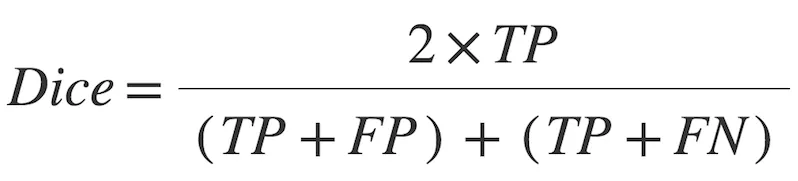
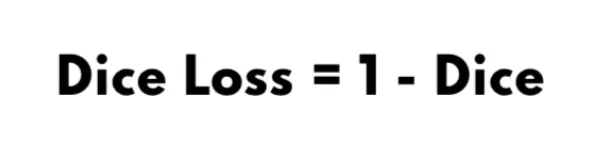

In [ ]:
model = Unet('resnet34', encoder_weights='imagenet', classes=22 , activation='softmax', input_shape=(256,256,3))

85521592/85521592 [==============================] - 2s 0us/step


In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 data (InputLayer)              [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 bn_data (BatchNormalization)   (None, 256, 256, 3)  9           ['data[0][0]']                   
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 262, 262, 3)  0          ['bn_data[0][0]']                
                                                                                                  
 conv0 (Conv2D)                 (None, 128, 128, 64  9408        ['zero_padding2d[0][0]']   

In [ ]:
aug2 = iaa.Fliplr(1)
aug3 = iaa.Flipud(1)
aug4 = iaa.Emboss(alpha=(1), strength=1)
aug5 = iaa.DirectedEdgeDetect(alpha=(0.8), direction=(1.0))
aug6 = iaa.Sharpen(alpha=(1.0), lightness=(1.5))

In [ ]:
def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        if i==1:
            plt.imshow(image, cmap='gray', vmax=1, vmin=0)
        else:
            plt.imshow(image)
    plt.show()
    
def normalize_image(mask):
    mask = mask/10
    return mask

Cоздадим класс для Dataset и для DataLoader, для более эффективной работы с данными

In [ ]:
class Dataset:
    CLASSES = {'guard rail': 120, 'traffic light': 130, 'motorcycle': 80, 'bicyclegroup': 80, 'vegetation': 160,
                           'tunnel': 150, 'building': 150, 'bus': 100, 'ground': 190, 'caravan': 100, 'sky': 170, 'bicycle': 80,
                           'terrain': 160, 'polegroup': 140, 'rectification border': 200, 'static': 10,
                           'trailer': 100, 'road': 20, 'traffic sign': 130, 'sidewalk': 40, 'train': 210,
                           'pole': 140, 'dynamic': 60, 'ego vehicle': 180, 'truck': 100, 'person': 60,
                           'parking': 30, 'wall': 110, 'bridge': 150, 'persongroup': 60,
                           'motorcyclegroup': 80, 'license plate': 130, 'rail track': 50,
                           'truckgroup': 100, 'cargroup': 90, 'ridergroup': 70, 'car': 90,
                           'out of roi': 0, 'rider': 70, 'fence': 120}
    
    def __init__(self, data_df, classes,width, height,augment_flag):
        
        self.w = width
        self.h = height
        self.data_df = data_df
        self.augment_flag = augment_flag
        self.images_fps = self.data_df['image'].values
        self.masks_fps = self.data_df['mask'].values
        self.class_values = np.unique([self.CLASSES[cls.lower()]//10 for cls in classes])
    
    def __getitem__(self, i):
        
        # read data
        image = cv2.imread(self.images_fps[i], cv2.IMREAD_UNCHANGED)
        image = cv2.resize(image,(self.w,self.h),interpolation=cv2.INTER_AREA)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        

        
        mask  = cv2.imread(self.masks_fps[i], cv2.IMREAD_UNCHANGED)
        mask = cv2.resize(mask,(self.w,self.h),interpolation=cv2.INTER_AREA)
        image_mask = normalize_image(mask)
        
        
        image_masks = [(image_mask == v) for v in self.class_values]
        image_mask = np.stack(image_masks, axis=-1).astype('float')
   
        if(self.augment_flag):
          a = np.random.uniform()
          if a<0.2:
              image = aug2.augment_image(image)
              image_mask = aug2.augment_image(image_mask)
          elif a<0.4:
              image = aug3.augment_image(image)
              image_mask = aug3.augment_image(image_mask)
          elif a<0.6:
              image = aug4.augment_image(image)
              image_mask = aug4.augment_image(image_mask)
          elif a<0.8:
              image = aug5.augment_image(image)
              image_mask = image_mask
          else:
              image = aug6.augment_image(image)
              image_mask = aug6.augment_image(image_mask)
            
        return image, image_mask
        
    def __len__(self):
        return len(self.data_df)
    

In [ ]:
class Dataloder(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

    def __getitem__(self, i):
        
        # collect batch data
        
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [ ]:
optim = tf.keras.optimizers.Adam()

focal_loss = sm.losses.cce_dice_loss

model.compile(optim, focal_loss, metrics=[iou_score])

Создадим Dataloader для тренировки и валидации, батчи будут размером 32, также будем сохранять наилучшую модель

In [ ]:
# Dataset for train images
width = 256
height = 256
CLASSES = unique_labels
train_dataset = Dataset(x_train, CLASSES,width,height,True)
test_dataset  = Dataset(x_test, CLASSES,width,height,False)

BATCH_SIZE=32
train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_dataloader = Dataloder(test_dataset, batch_size=BATCH_SIZE, shuffle=True)

print(train_dataloader[0][0].shape)
assert train_dataloader[0][0].shape == (BATCH_SIZE, width, height, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, width, height, 22)

# define callbacks for learning rate scheduling and best checkpoints saving
save_path = os.path.join(os.getcwd(),'drive','MyDrive','20_256_best_segmentation_model.h5')
callbacks = [
    tf.keras.callbacks.ModelCheckpoint(save_path, save_weights_only=True, save_best_only=True, \
                                       mode='max', monitor='val_iou_score'),
    #tf.keras.callbacks.ReduceLROnPlateau(monitor='val_iou_score', min_lr=0.0001,patience=3),
]


In [ ]:
model.load_weights('/content/drive/MyDrive/20_256_best_segmentation_model.h5')

In [ ]:
history = model.fit(train_dataloader, steps_per_epoch=len(train_dataloader), epochs=20,\
                              validation_data=test_dataloader,callbacks=callbacks)

Максимум iou на валидации, который у меня получилось достичь это 0.401

Напишем функции predict которая будет показывать сегментацию для рандомных 10 фотографий из валидационной выборки

In [ ]:
def predict(model):
  #getting random 10 samples from test data
  random_samples = np.random.choice(list(range(0,len(x_test))),10)
  #iterating over samples
  for i in random_samples:
    #getting input image
    image_path = x_test.iloc[i]['image']
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    image = cv2.resize(image,(256,256),interpolation=cv2.INTER_AREA)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    #getting actual mask
    mask_path = x_test.iloc[i]['mask']
    image_mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
    image_mask = cv2.resize(image_mask,(256,256),interpolation=cv2.INTER_AREA)

    #getting predicted mask image
    prediction = model.predict(image[np.newaxis,:,:,:])
    prediction = tf.argmax(prediction,axis=-1)
    prediction = tf.expand_dims(prediction,axis=-1)

    plt.figure(figsize=(10,6))
    plt.subplot(131)
    plt.imshow(image)
    plt.subplot(132)
    plt.imshow(image_mask)
    plt.subplot(133)
    plt.imshow(prediction[0,:,:,0])
    plt.show()

1/1 [==============================] - 2s 2s/step


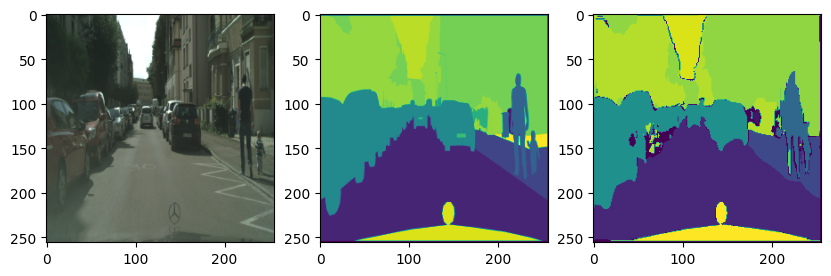

1/1 [==============================] - 0s 409ms/step


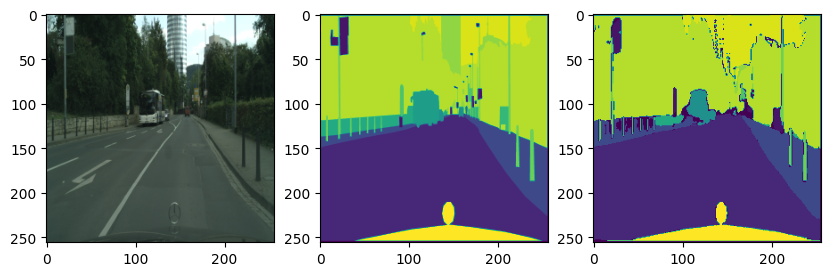

1/1 [==============================] - 0s 373ms/step


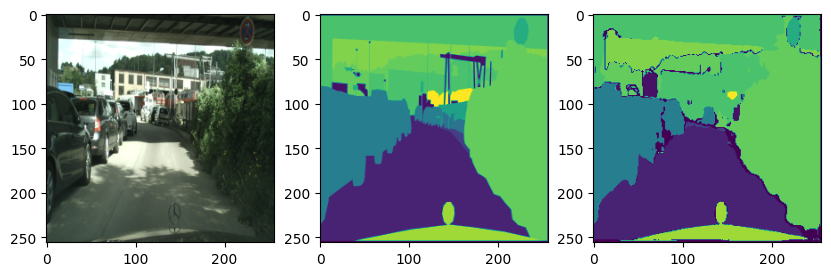

1/1 [==============================] - 0s 382ms/step


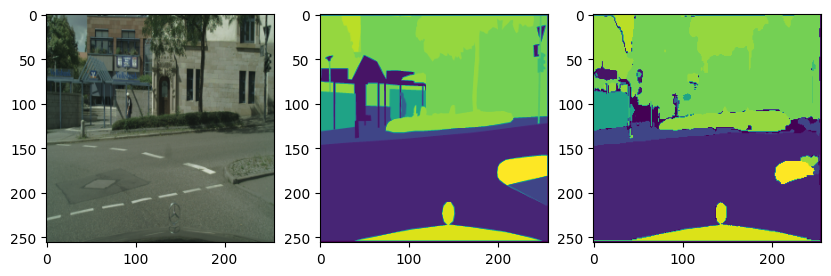

1/1 [==============================] - 0s 371ms/step


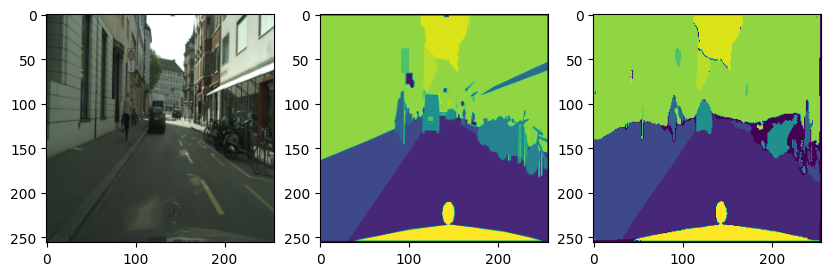

1/1 [==============================] - 0s 374ms/step


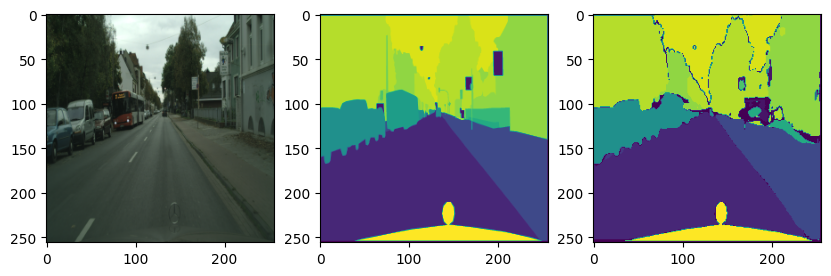

1/1 [==============================] - 1s 702ms/step


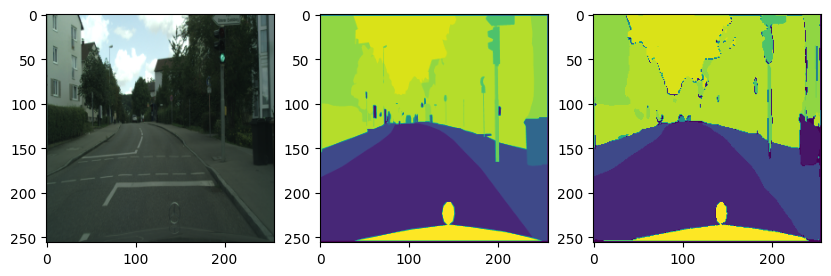

1/1 [==============================] - 1s 731ms/step


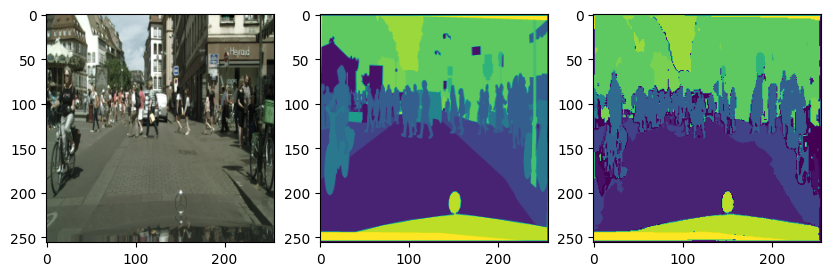

1/1 [==============================] - 0s 383ms/step


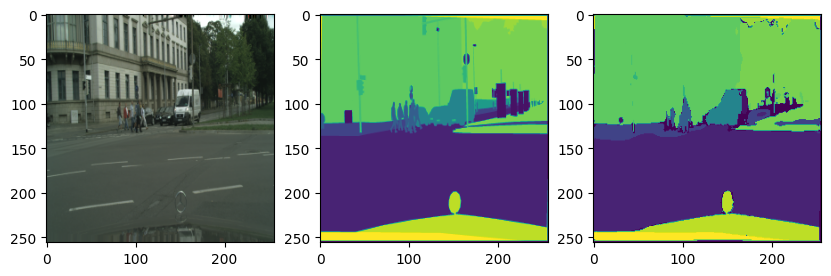

1/1 [==============================] - 0s 363ms/step


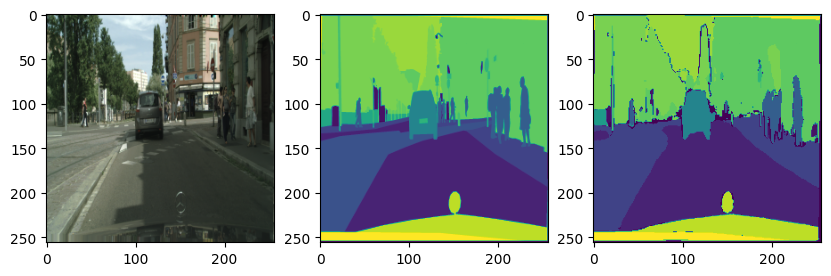

In [ ]:
predict(model)

Также я захотел сделать предсказания на видео, основываясь на том что видео это лишь последовательность картинок

In [ ]:
from pytube import YouTube

# where to save
SAVE_PATH = os.path.join(os.getcwd())

# link of the video to be downloaded
# link="https://www.youtube.com/watch?v=d59wPaenvzs"
link = 'https://www.youtube.com/watch?v=lBlKR2ek0w4'

YouTube(link).streams.filter(res='720p').first().download(SAVE_PATH)

In [ ]:
# Importing all necessary libraries
import cv2
import os

SAVE_PATH = os.path.join(os.getcwd())
# Read the video from specified path
cam = cv2.VideoCapture(os.path.join(SAVE_PATH,'Berlin - Germany 🇩🇪 Driving Tour [4K] Alexanderplatz Potsdamer Platz Brandenburg Gate West-Berlin.mp4'))

try:
	
	# creating a folder named data
	if not os.path.exists('video_data'):
		os.makedirs('video_data')

except OSError:
	print ('Error: Creating directory of video_data')

# frame
currentframe = 0

while(currentframe <= 1000):
	
	# reading from frame
    ret,frame = cam.read()

    if ret:
        # if video is still left continue creating images
        name = os.path.join(os.getcwd(),'video_data','frame' + str(currentframe) + '.jpg')
        # writing the extracted images
        cv2.imwrite(name, frame)

        currentframe += 1
    else:
        break

# Release all space and windows once done
cam.release()
cv2.destroyAllWindows()


In [ ]:
i=0
if(not os.path.exists(os.path.join(os.getcwd(),'mask_data'))):
  os.mkdir(os.path.join(os.getcwd(),'mask_data'))

frames = len(os.listdir(os.path.join(os.getcwd(),'video_data')))
frames

#iterating over all the video frames
while(i!=frames):
  
  #Getting the image abd resizing it according to our input model
  image_path = os.path.join(os.getcwd(),'video_data','frame'+str(i)+'.jpg')
  image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
  image = cv2.resize(image,(256,256),interpolation=cv2.INTER_AREA)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  #getting the prediction mask image
  prediction = model.predict(image[np.newaxis,:,:,:])
  prediction = tf.argmax(prediction,axis=-1)
  prediction = tf.expand_dims(prediction,axis=-1)

  #saving the mask image
  mask_path = os.path.join(os.getcwd(),'mask_data','frame'+str(i)+'.png')
  plt.imsave(mask_path, prediction[0,:,:,0])
  plt.close()
  i+=1





In [ ]:
import math
from PIL import Image, ImageDraw
from PIL import ImagePath
import pandas as pd
import os
from os import path
from tqdm import tqdm
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
import urllib



i=0
total_frames = len(os.listdir(os.path.join(os.getcwd(),'video_data')))
while(i<total_frames):
    print('frame ',i)
    image_path = os.path.join(os.getcwd(),'video_data','frame'+str(i)+'.jpg')
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    image = cv2.resize(image,(512,512),interpolation=cv2.INTER_AREA)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    mask = cv2.imread(os.path.join(os.getcwd(),'mask_data','frame'+str(i)+'.png'))
    mask = cv2.resize(mask,(512,512),interpolation=cv2.INTER_AREA)
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
    dst = cv2.addWeighted(image, 0.5, mask, 0.7, 0)
    cv2.imshow('mask',dst)
    cv2.waitKey(20)
    i = i+1
cv2.destroyAllWindows()


### Results

In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/drive/MyDrive/Results.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## Что можно сделать дальше

1. Можно использовать более качественные модели(ViT-Adapter, Hierarchical Multi-Scale Attention и т.д.)
2. Можно поменять числовую разметку для классов(изменить license plate)
3. Обучиться на большем количестве эпох
4. Вместо библиотеки segmentation_models можно использовать mmseg и mmcv
5. Увеличить количество слоев и размерность изображений на входе(512x512 вместо 256x256)